In [1]:
import numpy as np
import torch
import torch.optim as optim
import torch.nn as nn
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from tqdm import tqdm

from IPython.display import HTML

In [2]:
seed = 999
torch.manual_seed(seed)
np.random.seed(seed)

In [3]:
dataset_root = "dataset"
image_size = 64
batch_size = 128
num_workers = 16
device = torch.device("cuda")
# Number of channels in data image
nc = 3
# Number of channels in latent vector
nz = 100
# Size of the image generated by generator
ngf = 64
# Size of feature map in discriminator
ndf = 64

# Learning rate
lr = 0.0002
# beta 1 for Adam
beta1 = 0.5

# Number of training epochs
num_epochs = 10

In [4]:
dataset = dset.ImageFolder(
    root=dataset_root,
    transform=transforms.Compose([
        transforms.Resize(image_size),
        transforms.CenterCrop(image_size),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ])
)

In [5]:
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=num_workers)

In [6]:
# Plot some training images
real_batch = next(iter(dataloader))

In [7]:
real_batch[0].shape

torch.Size([128, 3, 64, 64])

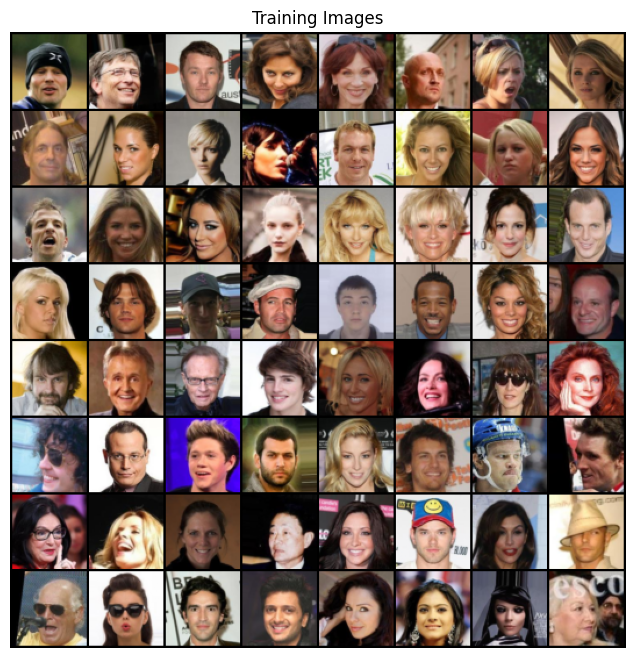

In [8]:
# Actually plot it
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(
    np.transpose(
        vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),
        (1, 2, 0)
    )
)

In [9]:
def weight_init(m):
    """Custom weight initialization called on netG and netD"""
    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find("BatchNorm") != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.normal_(m.bias.data, 0)

In [10]:
# Generator code
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size: (ngf * 8) * 4 * 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size: (ngf * 4) * 8 * 8
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size: (ngf * 2) * 16 * 16
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size: ngf * 32 * 32
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size: nc * 64 * 64
        )
    
    def forward(self, input):
        return self.main(input)

In [11]:
netG = Generator().to(device)
netG.apply(weight_init)
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [12]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            # state size: nc * 64 * 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size: ndf * 32 * 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size: (ndf*2) * 16 * 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size: (ndf*4) * 8 * 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size: (ndf*8) * 4 * 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )
    
    def forward(self, input):
        return self.main(input)

In [13]:
netD = Discriminator().to(device)
netD.apply(weight_init)
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [14]:
critetion = nn.BCELoss()

fixed_noise = torch.randn(64, nz, 1, 1, device=device)

real_label = 1.
fake_label = 0.

optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))

In [15]:
# Training loop

img_list = list()
G_losses = list()
D_losses = list()
iters = 0

print("Staring training loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in dataloader
    for i, data in tqdm(enumerate(dataloader, 0)):
        # Update D network
        # maximize log(D(x)) using batch of real images
        # maximize log(1 - D(G(z))) using batch of fake images

        # Train with real batch
        netD.zero_grad()
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        output = netD(real_cpu).view(-1)
        errD_real = critetion(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        # Train with fake batch
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(fake_label)
        output = netD(fake.detach()).view(-1)
        errD_fake = critetion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake

        optimizerD.step()

        # Train generator: maximize log(D(G(z)))
        netG.zero_grad()
        label.fill_(real_label)
        output = netD(fake).view(-1)
        errG = critetion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()

        if i % 500 == 0:
            tqdm.write("\n".join((
                f"epoch: {epoch}/{num_epochs}, iter: {i}/{len(dataloader)}, Loss D: {errD.item()}, Loss G: {errG.item()}",
                f"D_x: {D_x:.4f}, D_G_z1: {D_G_z1:.4f}, D_G_z2: {D_G_z2:.4f}"
            )))
        
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0 or ((epoch == num_epochs - 1) and (i == len(dataloader) - 1))):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
        
        iters += 1


Staring training loop...


0it [00:00, ?it/s]MIOpen(HIP): Warning [SQLiteBase] Missing system database file: gfx1030_14.kdb Performance may degrade. Please follow instructions to install: https://github.com/ROCmSoftwarePlatform/MIOpen#installing-miopen-kernels-package
0it [00:14, ?it/s]

epoch: 0/10, iter: 0/1583, Loss D: 2.070673704147339, Loss G: 2.304918050765991
D_x: 0.2453, D_G_z1: 0.3570, D_G_z2: 0.1282


502it [01:11,  9.40it/s]

epoch: 0/10, iter: 500/1583, Loss D: 1.4576929807662964, Loss G: 8.780024528503418
D_x: 0.9798, D_G_z1: 0.7261, D_G_z2: 0.0003


1002it [02:04,  8.93it/s]

epoch: 0/10, iter: 1000/1583, Loss D: 0.5425333976745605, Loss G: 3.108231544494629
D_x: 0.7502, D_G_z1: 0.1557, D_G_z2: 0.0833


1502it [03:00,  8.82it/s]

epoch: 0/10, iter: 1500/1583, Loss D: 0.48923903703689575, Loss G: 3.3261611461639404
D_x: 0.6976, D_G_z1: 0.0275, D_G_z2: 0.0563


1583it [03:50,  6.87it/s]
2it [00:00,  4.17it/s]

epoch: 1/10, iter: 0/1583, Loss D: 0.3257383704185486, Loss G: 3.8971056938171387
D_x: 0.8108, D_G_z1: 0.0794, D_G_z2: 0.0310


502it [00:54,  8.85it/s]

epoch: 1/10, iter: 500/1583, Loss D: 0.97946697473526, Loss G: 1.0069396495819092
D_x: 0.4480, D_G_z1: 0.0184, D_G_z2: 0.4186


1002it [01:51,  8.61it/s]

epoch: 1/10, iter: 1000/1583, Loss D: 2.0890698432922363, Loss G: 0.8842753171920776
D_x: 0.1682, D_G_z1: 0.0030, D_G_z2: 0.4761


1502it [02:49,  8.48it/s]

epoch: 1/10, iter: 1500/1583, Loss D: 0.5145531892776489, Loss G: 2.3457252979278564
D_x: 0.8222, D_G_z1: 0.2443, D_G_z2: 0.1210


1583it [02:59,  8.83it/s]
2it [00:00,  3.79it/s]

epoch: 2/10, iter: 0/1583, Loss D: 1.7527523040771484, Loss G: 0.6022898554801941
D_x: 0.2215, D_G_z1: 0.0077, D_G_z2: 0.5800


502it [00:59,  8.25it/s]

epoch: 2/10, iter: 500/1583, Loss D: 0.9530128240585327, Loss G: 1.1233446598052979
D_x: 0.4495, D_G_z1: 0.0339, D_G_z2: 0.3846


1002it [01:59,  8.40it/s]

epoch: 2/10, iter: 1000/1583, Loss D: 0.7657039165496826, Loss G: 0.801010251045227
D_x: 0.5729, D_G_z1: 0.1223, D_G_z2: 0.4854


1502it [03:00,  8.26it/s]

epoch: 2/10, iter: 1500/1583, Loss D: 0.5690701007843018, Loss G: 2.0962347984313965
D_x: 0.7346, D_G_z1: 0.1892, D_G_z2: 0.1515


1583it [03:10,  8.32it/s]
2it [00:00,  4.21it/s]

epoch: 3/10, iter: 0/1583, Loss D: 0.675750195980072, Loss G: 1.6675293445587158
D_x: 0.5825, D_G_z1: 0.0743, D_G_z2: 0.2249


502it [01:00,  8.40it/s]

epoch: 3/10, iter: 500/1583, Loss D: 0.7617015838623047, Loss G: 1.153573751449585
D_x: 0.5725, D_G_z1: 0.1294, D_G_z2: 0.3491


1002it [02:01,  8.34it/s]

epoch: 3/10, iter: 1000/1583, Loss D: 0.6245406270027161, Loss G: 1.4647585153579712
D_x: 0.6102, D_G_z1: 0.0699, D_G_z2: 0.2832


1502it [03:01,  8.24it/s]

epoch: 3/10, iter: 1500/1583, Loss D: 0.5414117574691772, Loss G: 3.498076915740967
D_x: 0.9058, D_G_z1: 0.3263, D_G_z2: 0.0379


1583it [03:11,  8.27it/s]
2it [00:00,  4.33it/s]

epoch: 4/10, iter: 0/1583, Loss D: 0.467806339263916, Loss G: 2.0041797161102295
D_x: 0.7173, D_G_z1: 0.0986, D_G_z2: 0.1690


502it [01:00,  8.23it/s]

epoch: 4/10, iter: 500/1583, Loss D: 0.5495322346687317, Loss G: 1.4624826908111572
D_x: 0.6472, D_G_z1: 0.0685, D_G_z2: 0.2702


1002it [02:00,  8.32it/s]

epoch: 4/10, iter: 1000/1583, Loss D: 0.4758942127227783, Loss G: 2.664304256439209
D_x: 0.8915, D_G_z1: 0.2827, D_G_z2: 0.0895


1502it [03:00,  8.27it/s]

epoch: 4/10, iter: 1500/1583, Loss D: 0.4673793613910675, Loss G: 2.1798315048217773
D_x: 0.7689, D_G_z1: 0.1561, D_G_z2: 0.1352


1583it [03:10,  8.31it/s]
2it [00:00,  4.42it/s]

epoch: 5/10, iter: 0/1583, Loss D: 0.40045931935310364, Loss G: 2.2272045612335205
D_x: 0.7861, D_G_z1: 0.1307, D_G_z2: 0.1322


502it [01:00,  8.28it/s]

epoch: 5/10, iter: 500/1583, Loss D: 0.4181006848812103, Loss G: 3.3250315189361572
D_x: 0.9205, D_G_z1: 0.2661, D_G_z2: 0.0434


1002it [02:00,  8.39it/s]

epoch: 5/10, iter: 1000/1583, Loss D: 0.43497374653816223, Loss G: 2.080811023712158
D_x: 0.7513, D_G_z1: 0.1065, D_G_z2: 0.1462


1502it [03:00,  8.45it/s]

epoch: 5/10, iter: 1500/1583, Loss D: 0.3700498342514038, Loss G: 2.622864246368408
D_x: 0.8966, D_G_z1: 0.2103, D_G_z2: 0.0925


1583it [03:10,  8.30it/s]
2it [00:00,  4.32it/s]

epoch: 6/10, iter: 0/1583, Loss D: 0.47463181614875793, Loss G: 2.2005693912506104
D_x: 0.6995, D_G_z1: 0.0771, D_G_z2: 0.1367


502it [01:00,  8.28it/s]

epoch: 6/10, iter: 500/1583, Loss D: 2.149972915649414, Loss G: 0.7360712885856628
D_x: 0.1601, D_G_z1: 0.0033, D_G_z2: 0.5344


1002it [02:00,  8.27it/s]

epoch: 6/10, iter: 1000/1583, Loss D: 0.4092826247215271, Loss G: 2.3782706260681152
D_x: 0.8515, D_G_z1: 0.1977, D_G_z2: 0.1096


1502it [03:00,  8.30it/s]

epoch: 6/10, iter: 1500/1583, Loss D: 0.4192884564399719, Loss G: 1.9046518802642822
D_x: 0.7346, D_G_z1: 0.0757, D_G_z2: 0.1791


1583it [03:10,  8.32it/s]
2it [00:00,  4.66it/s]

epoch: 7/10, iter: 0/1583, Loss D: 1.2295513153076172, Loss G: 5.866008758544922
D_x: 0.9911, D_G_z1: 0.6532, D_G_z2: 0.0040


502it [00:59,  8.68it/s]

epoch: 7/10, iter: 500/1583, Loss D: 0.520734429359436, Loss G: 4.895083427429199
D_x: 0.9721, D_G_z1: 0.3619, D_G_z2: 0.0107


1002it [01:57,  8.62it/s]

epoch: 7/10, iter: 1000/1583, Loss D: 0.3062644302845001, Loss G: 3.465144634246826
D_x: 0.9527, D_G_z1: 0.2116, D_G_z2: 0.0400


1502it [02:54,  8.70it/s]

epoch: 7/10, iter: 1500/1583, Loss D: 0.5242477655410767, Loss G: 1.9846094846725464
D_x: 0.6588, D_G_z1: 0.0529, D_G_z2: 0.1763


1583it [03:04,  8.60it/s]
2it [00:00,  5.21it/s]

epoch: 8/10, iter: 0/1583, Loss D: 0.3711252808570862, Loss G: 3.9323506355285645
D_x: 0.9757, D_G_z1: 0.2687, D_G_z2: 0.0255


502it [00:58,  8.63it/s]

epoch: 8/10, iter: 500/1583, Loss D: 0.6598448157310486, Loss G: 1.797844648361206
D_x: 0.5956, D_G_z1: 0.0586, D_G_z2: 0.2087


1002it [01:56,  8.73it/s]

epoch: 8/10, iter: 1000/1583, Loss D: 1.0449689626693726, Loss G: 3.7245378494262695
D_x: 0.9075, D_G_z1: 0.5581, D_G_z2: 0.0334


1502it [02:53,  8.58it/s]

epoch: 8/10, iter: 1500/1583, Loss D: 0.20377498865127563, Loss G: 2.733832836151123
D_x: 0.8995, D_G_z1: 0.0863, D_G_z2: 0.0830


1583it [03:03,  8.64it/s]
2it [00:00,  5.06it/s]

epoch: 9/10, iter: 0/1583, Loss D: 1.0784626007080078, Loss G: 7.25778865814209
D_x: 0.9965, D_G_z1: 0.6011, D_G_z2: 0.0011


502it [00:58,  8.63it/s]

epoch: 9/10, iter: 500/1583, Loss D: 0.4240878224372864, Loss G: 2.6135058403015137
D_x: 0.8142, D_G_z1: 0.1668, D_G_z2: 0.0960


1002it [01:56,  8.58it/s]

epoch: 9/10, iter: 1000/1583, Loss D: 0.2215074896812439, Loss G: 3.0739192962646484
D_x: 0.8668, D_G_z1: 0.0675, D_G_z2: 0.0616


1502it [02:54,  8.60it/s]

epoch: 9/10, iter: 1500/1583, Loss D: 0.27462682127952576, Loss G: 2.9057862758636475
D_x: 0.8569, D_G_z1: 0.0998, D_G_z2: 0.0726


1583it [03:03,  8.62it/s]


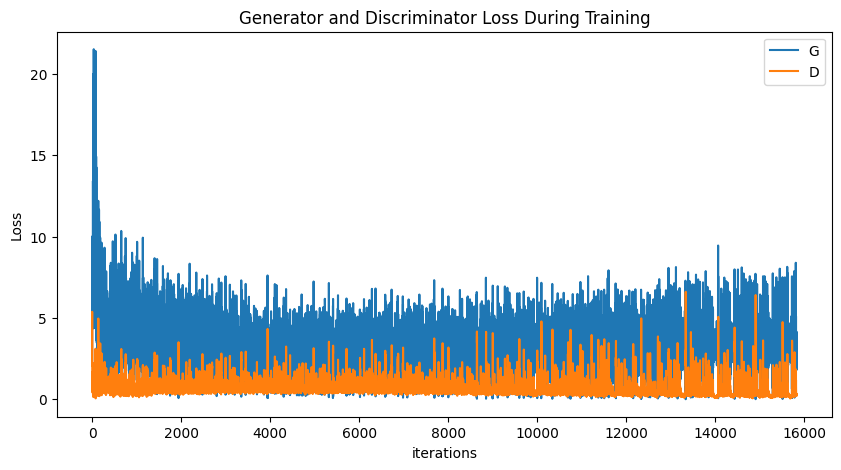

In [16]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses, label="G")
plt.plot(D_losses, label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21317242 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


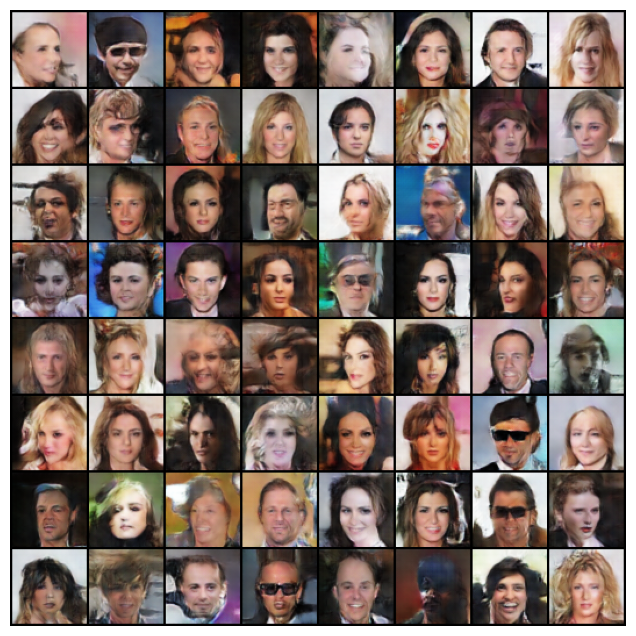

In [17]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

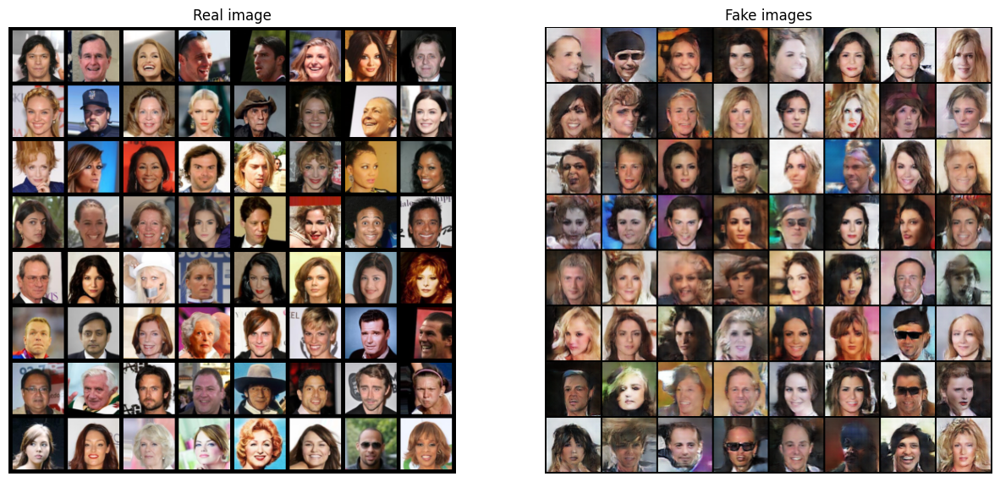

In [18]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

plt.figure(figsize=(15, 15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real image")
plt.imshow(np.transpose(
    vutils.make_grid(
        real_batch[0].to(device)[:64],
        padding=5,
        normalize=True
    ).cpu(), (1,2,0))
)

plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()